In [1]:
from astropy.io import fits
from astropy.wcs import WCS
from astropy.coordinates import Angle
import astropy.units as u

In [2]:
# Calibrated File
cal_fit = 'Light_WUMa_10.0s_Bin1_20240416-204402_0001_cal.fit'

# Tri color green extracted file
tg_fit = 'Light_WUMa_10.0s_Bin1_20240416-204402_0001_cal_TG.fit'

In [3]:
# This function assigns RA, DEC to each pixel based upon WCS FITS header.
def get_radec_at_pixel(fits_file, x, y):
    with fits.open(fits_file) as hdul:
        header = hdul[0].header
    
    wcs = WCS(header)
    
    ra_deg, dec_deg = wcs.all_pix2world(x, y, 0)  
    
    ra_angle = Angle(ra_deg, unit=u.degree)
    dec_angle = Angle(dec_deg, unit=u.degree)
    
    return ra_angle, dec_angle

# ASTAP

* Calibrated FIT
* Coordinates of W UMa: (2093, 1363)

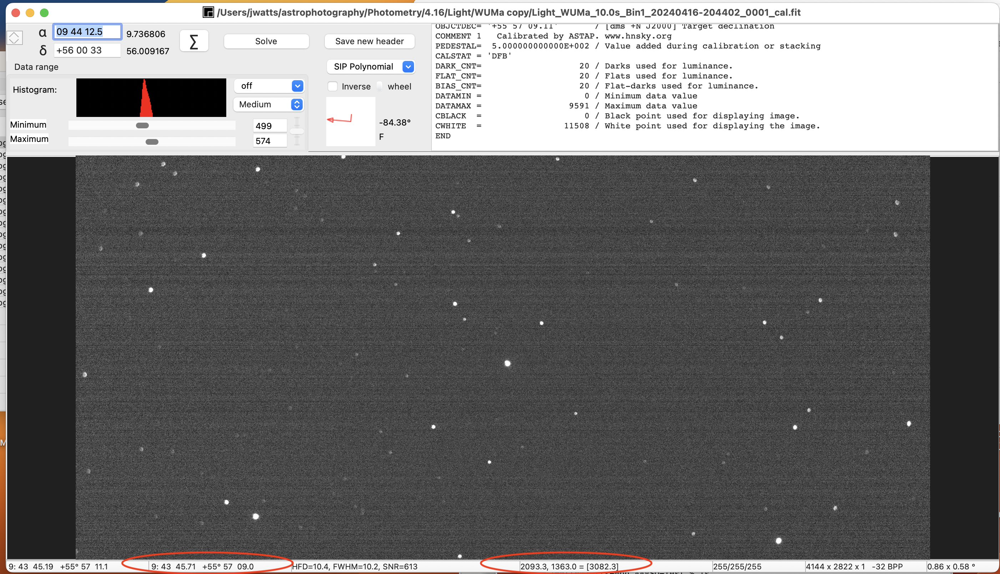

In [4]:
# Use Coorinates from ASTAP_CAL
x_astap_cal = 2093
y_astap_cal = 1363

ra_astap_cal, dec_astap_cal = get_radec_at_pixel(cal_fit, x_astap_cal, y_astap_cal)
print("RA: ", ra_astap_cal.to_string(unit=u.hourangle, sep=':'))
print("Dec: ", dec_astap_cal.to_string(unit=u.degree, sep=':'))


RA:  9:43:45.28091184
Dec:  55:57:10.6356329


# ASTAP

* Tricolor Green Extracted FIT
* Coordinates of W UMa (1051, 685)

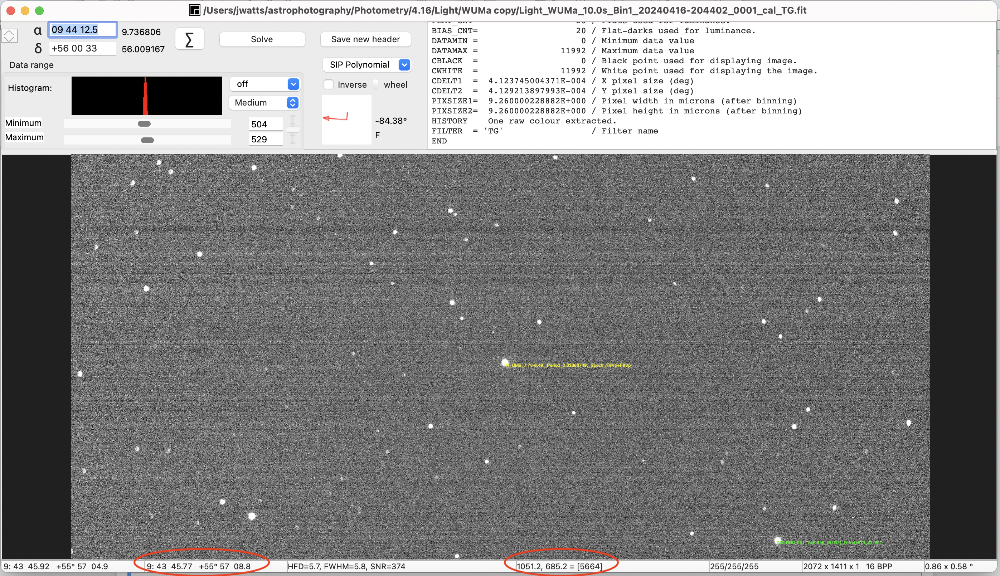

In [5]:
# Coordinates from ASTAP_TG
x_astap_tg = 1051
y_astap_tg = 685

ra_astap_tg, dec_astap_tg = get_radec_at_pixel(tg_fit, x_astap_tg, y_astap_tg)
print("RA: ", ra_astap_tg.to_string(unit=u.hourangle, sep=':'))
print("Dec: ", dec_astap_tg.to_string(unit=u.degree, sep=':'))

RA:  9:43:46.07384464
Dec:  55:57:03.82506495


### ASTAP Delta between Cal and TG

In [6]:
# Difference between Cal and TG
print(f"RA delta: {(ra_astap_tg-ra_astap_cal).to_string(unit=u.hourangle, sep=':')}")
print(f"DEC delta: {(dec_astap_tg-dec_astap_cal).to_string(unit=u.degree, sep=':')}")

RA delta: 0:00:00.79293279
DEC delta: -0:00:06.81056796


# SIRIL

* Calibrated FIT
* Coordinates of W UMa: (2094, 1454)

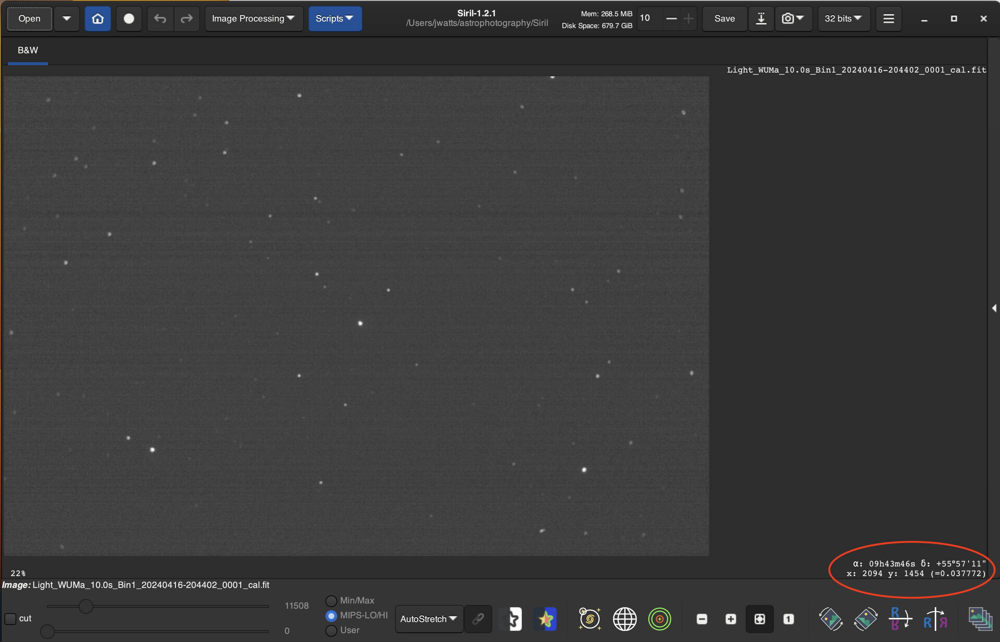
    


In [7]:
# Use Coorinates from SIRIL_CAL
x_siril_cal = 2094
y_siril_cal = 1454

ra_siril_cal, dec_siril_cal = get_radec_at_pixel(cal_fit, x_siril_cal, y_siril_cal)
print("RA: ", ra_siril_cal.to_string(unit=u.hourangle, sep=':'))
print("Dec: ", dec_siril_cal.to_string(unit=u.degree, sep=':'))


RA:  9:43:53.30433555
Dec:  55:57:16.59548083


# Siril

* Tricolor Green Extracted FIT
* Coordinates of W UMa (1049, 725)

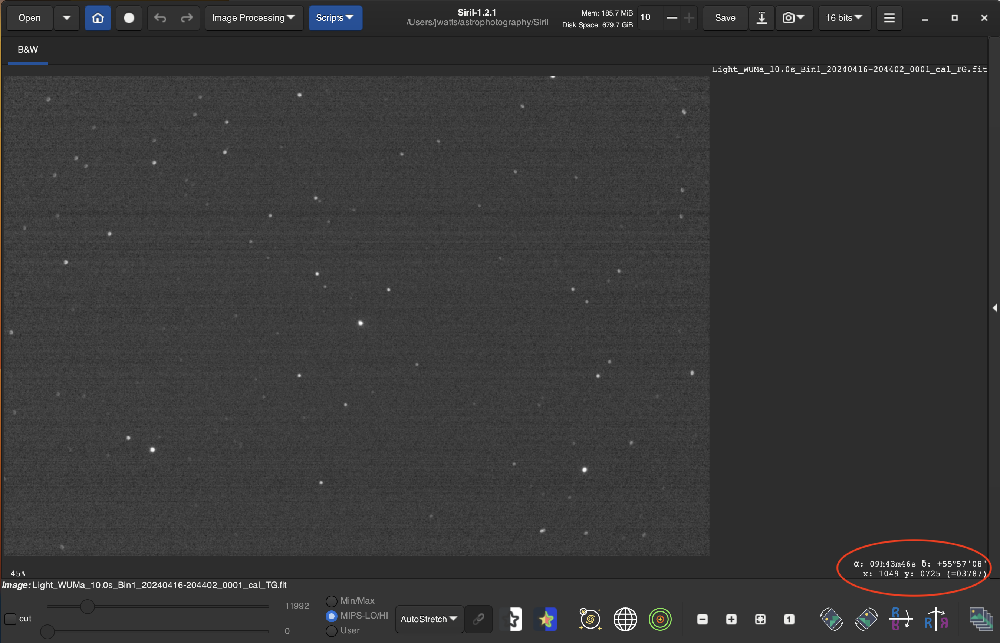

In [8]:
# Use Coorinates from SIRIL_TG
x_siril_tg = 1049
y_siril_tg = 725

ra_siril_tg, dec_siril_tg = get_radec_at_pixel(tg_fit, x_siril_tg, y_siril_tg)
print("RA: ", ra_siril_tg.to_string(unit=u.hourangle, sep=':'))
print("Dec: ", dec_siril_tg.to_string(unit=u.degree, sep=':'))


RA:  9:43:53.08414113
Dec:  55:57:12.67437249


### SIRIL Delta

In [9]:
# Difference between Cal and TG
print(f"RA delta: {(ra_siril_tg-ra_siril_cal).to_string(unit=u.hourangle, sep=':')}")
print(f"DEC delta: {(dec_siril_tg-dec_siril_cal).to_string(unit=u.degree, sep=':')}")

RA delta: -0:00:00.22019441
DEC delta: -0:00:03.92110834


 # VPHOT
 
 Import Screen
 
 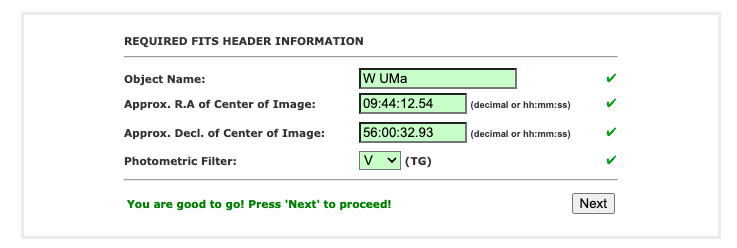

In [10]:
vphot_ra = Angle("9h44m12.54s")
vphot_dec = Angle("56d0m32.93s")

In [11]:
# Difference between ASTAP and VPHOT
print(f"RA delta: {(ra_astap_tg-vphot_ra).to_string(unit=u.hourangle, sep=':')}")
print(f"DEC delta: {(dec_astap_tg-vphot_dec).to_string(unit=u.degree, sep=':')}")

RA delta: -0:00:26.46615536
DEC delta: -0:03:29.10493505


In [12]:
# Difference between Siril and VPHOT
print(f"RA delta: {(ra_siril_tg-vphot_ra).to_string(unit=u.hourangle, sep=':')}")
print(f"DEC delta: {(dec_siril_tg-vphot_dec).to_string(unit=u.degree, sep=':')}")

RA delta: -0:00:19.45585887
DEC delta: -0:03:20.25562751
